### Imports

In [1]:
import pandas as pd
import numpy as np
import re
from ydata_profiling import ProfileReport
import eli5
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error as mse
from sklearn.model_selection import cross_val_score

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectFromModel
import xgboost as xgb
import lightgbm as lgb

from skopt import BayesSearchCV
from skopt.space import Real, Integer

import pickle

### Data

In [2]:
train_data = 'train_data.csv'

def read_data(train_data):
    data = pd.read_csv(train_data, index_col=0)
    # колонки, які можуть знадобитися (інші колонки або мають 1 унікальне значення
    # або це номер будинку)
    proto_features = [
         'name', 'full_description', 'subtitle', 'availabilityStarts_offers',
         'numberOfRooms', 'appartment_metrage', 'kitchen_metrage', 'bathroom_metrage',
         'priceCurrency_offers', 'convert_to_uah',
         'floor', 'floor_all', 'year_built', 
         'build_type', 'wall_type',
         'latitude_geo', 'longitude_geo','street', 'district', 'district2', 
         'price_offers']
    df = data.loc[:, proto_features]
    df.loc[:, 'price_uah'] = df.loc[:, 'convert_to_uah'] * df.loc[:, 'price_offers']
    return df


def сorrection(df):
    # 1 - це пропущені значення
    df.kitchen_metrage = df.kitchen_metrage.replace([' - '], None).astype(float)
    df.bathroom_metrage = df.bathroom_metrage.replace([' - '], None).astype(float)
    df.kitchen_metrage = df.kitchen_metrage.replace(1, None).astype(float)
    df.bathroom_metrage = df.bathroom_metrage.replace(1, None).astype(float)
    # подивилася вручну за описом (якщо додам дані - потрібно ще раз передивлюватися)
    df['floor_all'] = df['floor_all'].replace(87, 9)
    df.loc[df[df.name=='ЖК Вудсторія'].isna().index, 'district2'] = 'Дарницький'
    df.numberOfRooms = df.numberOfRooms.replace([18, 19], 1)
    district2_set = df.district2.dropna().unique()
    extr_district = lambda x: [re.sub(r + 'Київ', '', str(x)) for r in district2_set if r in str(x)]
    # іноді в назві є ЖК <назва>МікрорайонРайонКиїв
    district_set = df.district.dropna().unique()
    distr_f = lambda x: [r for r in district_set if r in str(x)]
    one_distr = lambda x: x[-1] if x else None
    df.loc[df.district.isna().index, 'district'] = df.loc[df.district.isna().index, 'subtitle'].apply(
       extr_district).apply(distr_f).apply(one_distr)
    return df

df = сorrection(read_data(train_data))

In [3]:
report = ProfileReport(df, explorative=True)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
# обрізання хвостів
def preproces(df):
    df = df[(df.price_uah<=50_000)& (df.price_uah>4000)]
    df = df[df.numberOfRooms<5]
    df = df[(df.appartment_metrage<=150)&(df.appartment_metrage>=20)]
    df = df[df.wall_type!='блочні'] # таких аж 1 будинок
    df = df[df.year_built>=1950]
    return df

proc_df=preproces(df)

In [6]:
proc_report = ProfileReport(proc_df, explorative=True)
proc_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Data Preprocessing

In [4]:
stratify_col = 'district2'
target = 'price_uah'

num_cols = ['numberOfRooms', 'appartment_metrage', 
            'kitchen_metrage', 'bathroom_metrage',
            'floor', 'floor_all', 'year_built',
            'latitude_geo', 'longitude_geo']

cat_cols = ['build_type', 
            'wall_type', 
            'priceCurrency_offers',
            'district', 
            'district2']

skf = StratifiedKFold(n_splits=5, random_state=7568, shuffle=True)

X = proc_df[num_cols + cat_cols]
y = proc_df[target]

num_transformer = SimpleImputer(strategy='median')
cat_transformer = Pipeline(
    steps=[
            ('fillna', SimpleImputer(strategy='most_frequent')),
            ('onehot_enc', OneHotEncoder(handle_unknown='ignore')),
    ])

cat_transformer_bl = Pipeline(
    steps=[
            ('fillna', SimpleImputer(strategy='most_frequent')),
    ])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_transformer, num_cols),
        ('cat', cat_transformer, cat_cols),
    ])

### Baselines

In [27]:
# медіана
scores = []
for train, val in skf.split(X, X[stratify_col]):
    median = y.iloc[train].median()
    scores.append(mse(np.log10(y.iloc[val]), [np.log10(median)]*len(val), squared=False))
    
sum(scores)/len(scores)

0.21194161044071422

In [34]:
def groupby_median(col, median, train_df, val_df, target=target):
    med = train_df.groupby(col)[target].median()
    pred = val_df[col].map(med).fillna(median)
    return mse(np.log10(val_df[target]), np.log10(pred), squared=False)

In [35]:
def cv_groupby_col_median(col, df=proc_df, stratify_col=stratify_col, target=target):
    scores = []
    for train, val in skf.split(X, X[stratify_col]):
        median = y.iloc[train].median()
        scores.append(groupby_median(col, median, df.iloc[train], df.iloc[val], target))
    return sum(scores)/len(scores)

In [36]:
baselines = {col: cv_groupby_col_median(col) for col in 
             ['district2', 'district', 'appartment_metrage',
              'numberOfRooms', 'wall_type', 'build_type']}

pd.Series(baselines, name='rmlog10se')

district2             0.182038
district              0.175982
appartment_metrage    0.174264
numberOfRooms         0.194925
wall_type             0.178409
build_type            0.171340
Name: rmlog10se, dtype: float64

### Training

In [46]:
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
#     ('scaler', StandardScaler(with_mean=False)),
    ('model', LinearRegression())
])

-cross_val_score(estimator=pipeline, 
                X=X, y=np.log10(y), 
                scoring='neg_root_mean_squared_error',
                cv=skf.split(X, X[stratify_col])).mean()

0.09907095343082216

In [45]:
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('scaler', StandardScaler(with_mean=False)),
    ('model', Ridge(random_state=312))
])

params = {'model__alpha': Real(1e-4, 1e4, prior='log-uniform')}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X, X[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )

bayes_search.fit(X, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

(OrderedDict([('model__alpha', 17.909923182173493)]), -0.09904490331033336)

In [50]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('scaler', StandardScaler(with_mean=False)),
    ('poly_ftr', PolynomialFeatures()),                         
    ('model', Ridge(random_state=312))
])

params = {'model__alpha': Real(1e3, 1e5, prior='log-uniform')}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X, X[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )

bayes_search.fit(X, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 1min 35s
Wall time: 1min 36s


(OrderedDict([('model__alpha', 10894.964751474503)]), -0.09644079505136768)

In [57]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('scaler', StandardScaler(with_mean=False)),
    ('poly_ftr', PolynomialFeatures()),
    ('select_ftr', SelectFromModel(Lasso())),                          
    ('model', Ridge()),
])

params = {'model__alpha': Real(1e2, 1e3, prior='log-uniform'),
         'select_ftr__estimator__alpha': Real(1e-1, 10, prior='log-uniform'),}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X, X[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )

bayes_search.fit(X, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 16min 55s
Wall time: 17min 7s


(OrderedDict([('model__alpha', 1000.0),
              ('select_ftr__estimator__alpha', 1.9007710720718887)]),
 -0.10835039948246986)

In [23]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),                   
    ('model', RandomForestRegressor(n_estimators=150))
])

-cross_val_score(estimator=pipeline, 
                X=X, y=np.log10(y), 
                scoring='neg_root_mean_squared_error',
                cv=skf.split(X, X[stratify_col])).mean()

CPU times: total: 50.9 s
Wall time: 51 s


0.09675903575531673

In [25]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', lgb.LGBMRegressor(random_state=213)), # bayes search
])

-cross_val_score(estimator=pipeline, 
                X=X, y=np.log10(y), 
                scoring='neg_root_mean_squared_error',
                cv=skf.split(X, X[stratify_col])).mean()

CPU times: total: 4.44 s
Wall time: 439 ms


0.09438217549022485

In [27]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', lgb.LGBMRegressor(random_state=213)), # bayes search
])
params = {
    'model__max_depth': Integer(2, 20),
    'model__num_leaves': Integer(5, 105),
    'model__colsample_bytree': Real(0.3, 1),
    'model__n_estimators': Integer(10, 1000),
}
splits = skf.split(X, X[stratify_col])
bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=splits,
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )
bayes_search.fit(X, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 10min 21s
Wall time: 1min 23s


(OrderedDict([('model__colsample_bytree', 0.5708547455297768),
              ('model__max_depth', 2),
              ('model__n_estimators', 942),
              ('model__num_leaves', 5)]),
 -0.0931461366375893)

In [28]:
%%time
pipeline =  Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', xgb.XGBRFRegressor(random_state=213)),
])
params = {
    'model__n_estimators': Integer(10, 1000),
    'model__max_depth': Integer(2, 20),
    'model__colsample_bytree': Real(0.3, 1),
    
}
splits = skf.split(X, X[stratify_col])
bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=splits,
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )
bayes_search.fit(X, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 2h 16s
Wall time: 12min 35s


(OrderedDict([('model__colsample_bytree', 0.5422994170353963),
              ('model__max_depth', 20),
              ('model__n_estimators', 930)]),
 -0.09336631746700208)

### Feature Engineering

In [91]:
X_ftr = X.copy()
X_ftr.loc[:, 'm2_per_room'] = X_ftr.loc[:, 'appartment_metrage'] / X_ftr.loc[:, 'numberOfRooms'] 
X_ftr.loc[:, 'rel_floor'] = X_ftr.loc[:, 'floor'] / X_ftr.loc[:, 'floor_all']
X_ftr.loc[:, 'is_boiler'] = proc_df.full_description.apply(lambda x: 'бойлер' in str(x))
X_ftr.loc[:, 'is_air_cond'] = proc_df.full_description.apply(lambda x: ('кондиціонер' in str(x))
                                                                    or ('кондиционер' in str(x)))

X_ftr.loc[:, 'is_app_complex'] = proc_df.subtitle.apply(lambda x: 'ЖК' in str(x))
X_ftr.loc[:, 'is_subway'] = proc_df.full_description.apply(lambda x: 'метро' in str(x))
X_ftr.loc[:, 'is_ukr_lang'] = proc_df.full_description.apply(lambda x: 'i' in str(x).lower())                                                             )
X_ftr.loc[:, 'infrastructure'] = proc_df.full_description.apply(
    lambda x: 'нфраструктур' in str(x).lower() or "розв'язка" in str(x).lower()
    or "развязка" in str(x).lower())

X_ftr.loc[:, 'is_agency'] = proc_df.full_description.apply(
    lambda x: 'комісія' in str(x).lower() or 'комиссия' in str(x).lower())


In [163]:
X_ftr.groupby('district')['district2'].agg(lambda x: list(x)[0])

district
Історичний центр    Шевченківський
Академмістечко       Святошинський
Багринова гора       Голосіївський
Березняки             Дніпровський
Берковець            Святошинський
                         ...      
Чоколівка            Солом'янський
Чорна Гора              Печерський
Ширма                Голосіївський
Шулявка             Шевченківський
Ґалаґани             Святошинський
Name: district2, Length: 72, dtype: object

In [74]:
X_ftr.loc[:, 'infrastructure'].mean()

0.36137339055793993

In [31]:
ftr_report = ProfileReport(X_ftr, explorative=True)
ftr_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [92]:
num_cols = ['m2_per_room',
            'rel_floor',
            'numberOfRooms', 
            'appartment_metrage',
            'kitchen_metrage',
            'bathroom_metrage',
            'floor', 
            'floor_all',
            'year_built',
    'latitude_geo', 'longitude_geo',
]

cat_cols = ['is_boiler', 
            'is_air_cond', 
            'is_app_complex',
            'is_subway',
            'is_ukr_lang',
            'infrastructure',
            'is_agency',
            'build_type', 
            'wall_type', 
            'district',
            'district2',
            'priceCurrency_offers']

num_transformer = SimpleImputer(strategy='median')
cat_transformer = Pipeline(
    steps=[
            ('fillna', SimpleImputer(strategy='most_frequent')),
            ('onehot_enc', OneHotEncoder(handle_unknown='ignore')),
    ])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_transformer, num_cols),
        ('cat', cat_transformer, cat_cols),
    ])

### Training

In [93]:
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
#     ('scaler', StandardScaler(with_mean=False)),
    ('model', LinearRegression())
])

-cross_val_score(estimator=pipeline, 
                X=X_ftr[num_cols+cat_cols], y=np.log10(y), 
                scoring='neg_root_mean_squared_error',
                cv=skf.split(X_ftr, X_ftr[stratify_col])).mean()

0.09690478777593994

In [94]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('scaler', StandardScaler(with_mean=False)),
    ('poly_ftr', PolynomialFeatures()),                         
    ('model', Ridge(random_state=312))
])

params = {'model__alpha': Real(1e3, 1e5, prior='log-uniform')}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X_ftr, X_ftr[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )

bayes_search.fit(X_ftr, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 3min 58s
Wall time: 3min 59s


(OrderedDict([('model__alpha', 18619.100911799807)]), -0.0937532446884724)

In [95]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('scaler', StandardScaler(with_mean=False)),
    ('poly_ftr', PolynomialFeatures()),                         
    ('model', Ridge(random_state=312))
])

params = {'model__alpha': Real(1e3, 1e5, prior='log-uniform')}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X_ftr, X_ftr[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )

bayes_search.fit(X_ftr, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 3min 55s
Wall time: 3min 56s


(OrderedDict([('model__alpha', 18619.100911799807)]), -0.0937532446884724)

In [96]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),                   
    ('model', RandomForestRegressor(n_estimators=100))
])

-cross_val_score(estimator=pipeline, 
                X=X_ftr, y=np.log10(y), 
                scoring='neg_root_mean_squared_error',
                cv=skf.split(X_ftr, X_ftr[stratify_col])).mean()

CPU times: total: 54.8 s
Wall time: 54.8 s


0.09567350892657295

In [97]:
%%time
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', lgb.LGBMRegressor(random_state=213)), # bayes search
])
params = {
    'model__max_depth': Integer(2, 20),
    'model__num_leaves': Integer(5, 105),
    'model__colsample_bytree': Real(0.3, 1),
    'model__n_estimators': Integer(10, 700),
}
splits = skf.split(X_ftr, X_ftr[stratify_col])
bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=splits,
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )
bayes_search.fit(X_ftr, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

CPU times: total: 11min 10s
Wall time: 1min 29s


(OrderedDict([('model__colsample_bytree', 0.3),
              ('model__max_depth', 20),
              ('model__n_estimators', 644),
              ('model__num_leaves', 5)]),
 -0.09025422966808208)

In [64]:
%%time
pipeline =  Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', xgb.XGBRFRegressor(random_state=213)),
])
params = {
    'model__n_estimators': Integer(10, 700),
    'model__max_depth': Integer(2, 30),
    'model__colsample_bytree': Real(0.3, 1),
    
}

bayes_search = BayesSearchCV(estimator=pipeline,
                             search_spaces=params,
                             cv=skf.split(X_ftr, X_ftr[stratify_col]),
                             scoring='neg_root_mean_squared_error',
                             random_state=24143,
                         )
bayes_search.fit(X_ftr, np.log10(y))
bayes_search.best_params_, bayes_search.best_score_

c:\users\38096\appdata\local\programs\python\python38\lib\site-packages\skopt\optimizer\optimizer.py:449: UserWarning: The objective has been evaluated at this point before.
  warnings.warn("The objective has been evaluated "


CPU times: total: 1h 59min 36s
Wall time: 12min 27s


(OrderedDict([('model__colsample_bytree', 0.49503859403373374),
              ('model__max_depth', 30),
              ('model__n_estimators', 466)]),
 -0.09266001772355238)

In [57]:
for i in proc_df.full_description[232:333]:
    print( i, '\n')

Урловская ул. 38. Поверх 21/25. Площа 98 кв.м. Квартира з меблями та технікою. Три окремі кімнати. Дві лоджиї. Розвинута інфраструктура. Поруч ТРЦ Рівер Мол. Метро Осокорки та Позняки. Ціна оренди 12000 грн + к.у. Код №111442895 

Оболонь Оболонский р-н Современный термодом, видовая просторная квартира евродвушка, метро 10 мин. Новые стеклопакеты везде, санузел -- кафель, современная кухня, вся мебель в наличии. Бытовая техника: холодильник, стиральная машина - автомат, кондиционер, бойлер. ЖК находится в живописной части Киева на Оболони, охраняемая территория и шикарная зона отдыха на берегу озера. Вся необходимая мебель и техника. Квартира теплая зимой, прохладная в летнее время. Очень демократические коммунальные, дом на обслуживании ОСМД, установлены счётчики на все, включая тепловые. Консьерж круглосуточный. У дома элементы ландшафтного дизайна и озеленения. В ЖК есть подземный паркинг и наземные места для парковки. ЖК в целом имеет более развитую инфраструктуру. Вокруг расположе

### Interpretation

In [102]:
-cross_val_score(estimator=model_fin, X=X_ftr, y=y, scoring='neg_mean_absolute_error',
               cv=skf.split(X_ftr, X_ftr[stratify_col])).mean()

2255.8497689538904

In [106]:
-cross_val_score(estimator=model_fin, X=X_ftr, y=y, scoring='neg_mean_absolute_percentage_error',
               cv=skf.split(X_ftr, X_ftr[stratify_col])).mean()

0.17601142926637764

In [241]:
model_fin = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', lgb.LGBMRegressor(random_state=213,
                                colsample_bytree=0.3,
                                n_estimators=644,
                                num_leaves=5,
                               )),
])

model_fin.fit(X_ftr, np.log10(y))

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  SimpleImputer(strategy='median'),
                                                  ['m2_per_room', 'rel_floor',
                                                   'numberOfRooms',
                                                   'appartment_metrage',
                                                   'kitchen_metrage',
                                                   'bathroom_metrage', 'floor',
                                                   'floor_all', 'year_built',
                                                   'latitude_geo',
                                                   'longitude_geo']),
                                                 ('cat',
                                                  Pipeline(steps=[('fillna',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot_enc',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['is_boiler', 'is_air_cond',
                                                   'is_app_complex',
                                                   'is_subway', 'is_ukr_lang',
                                                   'infrastructure',
                                                   'is_agency', 'build_type',
                                                   'wall_type', 'district',
                                                   'district2',
                                                   'priceCurrency_offers'])])),
                ('model',
                 LGBMRegressor(colsample_bytree=0.3, n_estimators=644,
                               num_leaves=5, random_state=213))])

In [ ]:
cross_val_score

In [326]:
!jt -l

'jt' is not recognized as an internal or external command,
operable program or batch file.


In [278]:
feature_names = model_fin.named_steps['preprocessor'].get_feature_names_out()
eli5.show_weights(estimator = model_fin.named_steps['model'], feature_names=feature_names, top=30)

Weight,Feature
0.1453,num__appartment_metrage
0.1290,cat__priceCurrency_offers_UAH
0.0860,num__bathroom_metrage
0.0759,cat__wall_type_монолітно-каркасний
0.0695,cat__priceCurrency_offers_USD
0.0625,cat__is_app_complex_True
0.0604,cat__district2_Печерський
0.0595,num__longitude_geo
0.0573,cat__build_type_спец. проект
0.0409,num__numberOfRooms


In [146]:
pickle.dump(model_fin, open(r'C:\Users\38096\Documents\Projector_ML\project\models\model_fin_lgb.sav', 'wb'))

In [152]:
saved_model = pickle.load(
    open(r'C:\Users\38096\Documents\Projector_ML\project\models\model_fin_lgb.sav', 'rb'))

In [153]:
10**saved_model.predict(test)

array([11682.25098308])

### PostAnalyze

In [279]:
train_pred = model_fin.predict(X_ftr)

In [282]:
table = pd.DataFrame({'Actual': y, 'Predicted': 10**train_pred})

<Axes: xlabel='Actual', ylabel='Predicted'>

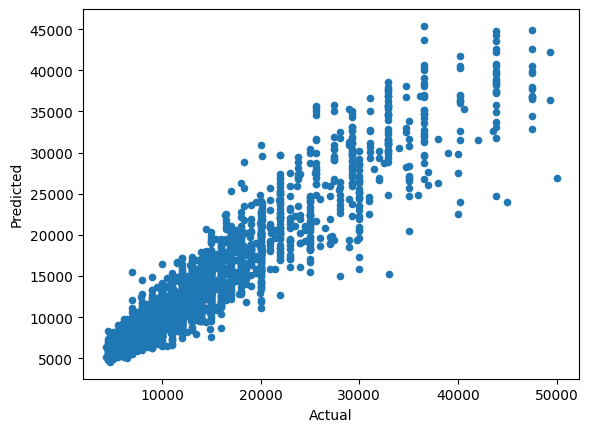

In [295]:
table.plot.scatter(x='Actual', y='Predicted')

In [307]:
table.loc[:, 'diff'] = (table.loc[:, 'Actual'] - table.loc[:, 'Predicted']).apply(abs)/table.loc[:, 'Actual']

<Axes: >

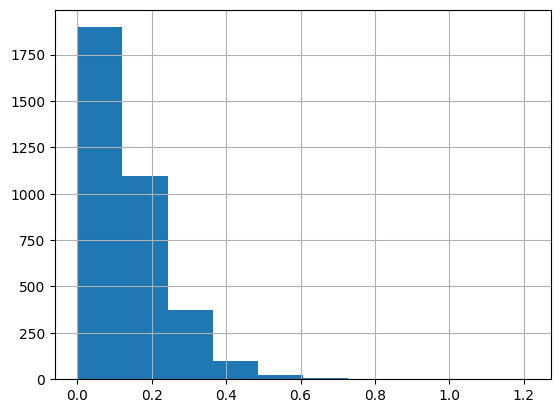

In [310]:
table.loc[:, 'diff'].hist()

In [320]:
attention = table[table['diff']>0.4].index

In [325]:
for i, j, l in zip(proc_df.loc[attention, 'full_description'], table.loc[attention, 'Actual'], \
table.loc[attention, 'Predicted']):
    print( i, j, l, '\n')

3 помещения! Офисное здание ЖК PECHERSKY со своей входной группой ,лифтом и охраной ,видеонаблюдением ! ул. Болсуновского 2 ( Струтинского 2 ). Помещение имеет 2 независимых входа (можно сдать 2 арендаторам).82/55/3 ,3 помещения +холл + 2 балкона. Возможность повесить вывеску ,так как окна выходят на фасад с ул. Болсуновского. Помещение под салон красоты, оздоровительный центр, стоматологию, обучение и т.п.; полностью отремонтированные качественными материалами . 82/20+16+18/ кухня 4 м кв. 3/8эт. кирпичного дома. наличие балконов ,где есть места для сидения и курения. Звуконепроницаемые помещения с глубокой изоляцией, плавающие полы. Установлены кондиционеры и дополнительное отопление. Освещение с ЛЕД лампами. Есть ресепшен, бойлер на 100л, 3х ступенчатая система очистки воды "Осмос" ,холодильник, видеодомофон и видеонаблюдение,2 санузла с душевыми, мокрые точки для стоматологии, електрорезетки в полу. Наличие мебели, стеклянных витрин, шкафа для одежды, и еще много интересных приспосо

<Axes: >

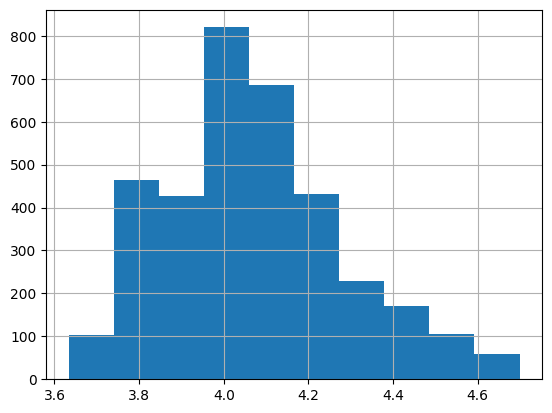

In [7]:
proc_df[target].apply(np.log10).hist()